utilise l'environnement py310_data_analysis2

# Relations avec les institutions et spatialisation

In [1]:
### Noter qu'il faudra avoir installé toutes les librairies nécessaires
# dans l'environnement conda utilisé pour exécuter ce carnet
import pandas as pd
import geopandas as gpd
from shapely.geometry import LineString
from geopandas.tools import sjoin
from geodatasets import get_path
import networkx as nx
import matplotlib.pyplot as plt
import plotly.express as px
from itables import init_notebook_mode, show
import numpy as np
import seaborn as sns
import json
import IPython

## Production des données

* Requête exécutée sur le serveur https://dbpedia.org/sparql 
* Période élargie jusqu'aux comtemporains-nes
* Propriétés prises en compte après inspection des propriétés de la population:
  * http://dbpedia.org/ontology/almaMater 
  * http://dbpedia.org/ontology/institution
* On ajoute les coordonnées géographiques
* Noter que la structure de la requête (sans clause OPTIONAL) exclut toutes les personnes pour lequelles une variable manque

```SPARQL
PREFIX dbr: <http://dbpedia.org/resource/>
PREFIX dbp: <http://dbpedia.org/property/>
PREFIX dbo: <http://dbpedia.org/ontology/>
PREFIX rdfs:<http://www.w3.org/2000/01/rdf-schema#>
SELECT DISTINCT (?o1 AS ?subject_uri) ?subjectBirthDate ?birthPlace ?birthPoint ?r_property ?organisation ?orgPoint
# (COUNT(*) AS ?effectif) 
WHERE {
  SELECT DISTINCT ?o1 ?subjectBirthDate  ?birthPlace ?birthPoint ?r_property ?organisation ?orgPoint
  WHERE { 
    {
           {dbr:List_of_archaeologists ?p ?o1.}
      UNION
          {?o1 ?p dbr:archaeologists.}
      UNION
          {?o1 ?p dbr:archaeology.}
      UNION
         {?o1 ?p dbr:antiquarian.}
    }
    ?o1 a dbo:Person;
      dbp:birthDate | dbo:birthDate ?subjectBirthDate;
      dbo:birthPlace ?birthPlace.
?birthPlace georss:point ?birthPoint;
     a  dbo:Settlement.
{
        {?o1 dbo:almaMater ?organisation.
     BIND('almaMater' AS ?r_property) }
UNION  {?o1 dbo:institution ?organisation.
     BIND('institution' AS ?r_property) }
}
?organisation  georss:point ?orgPoint.

    BIND(xsd:integer(SUBSTR(STR(?subjectBirthDate), 1, 4)) AS ?birthYear)
    FILTER ( (?birthYear >= 1451   ) )
 
          }
  ORDER BY ?birthYear
  }

```

## Inspecter les données

In [3]:
### Ouvrir le fichier et créer un DataFrame
fd = 'data/dbpedia_archeologue_spatialisation.csv'
df = pd.read_csv(fd)
len(df), df.head(2)

(128,
                                          subject_uri subjectBirthDate  \
 0  http://dbpedia.org/resource/Christian_Gottlob_...       1729-09-25   
 1       http://dbpedia.org/resource/Thomas_Jefferson       1743-04-13   
 
                                        birthPlace  \
 0            http://dbpedia.org/resource/Chemnitz   
 1  http://dbpedia.org/resource/Shadwell,_Virginia   
 
                               birthPoint r_property  \
 0  50.833333333333336 12.916666666666666  almaMater   
 1  38.012382833333334 -78.41777783333333  almaMater   
 
                                         organisation  \
 0     http://dbpedia.org/resource/Leipzig_University   
 1  http://dbpedia.org/resource/College_of_William...   
 
                                 orgPoint  
 0    51.33888888888889 12.37861111111111  
 1  37.270833333333336 -76.70833333333333  )

In [4]:
### Raccourcir l'URI, extraire l'année de naissance
df['subject_uri'] = df['subject_uri'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['organisation'] = df['organisation'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['birthPlace'] = df['birthPlace'].apply(lambda x : x.replace('http://dbpedia.org/resource/', ''))
df['BirthYear'] = df['subjectBirthDate'].apply(lambda x : int(x[:4]))

In [6]:
### Séparer longitude et latitude, arrondir
df['latitudeBirth'] = df['birthPoint'].apply(lambda x : round(float((x.split(' ')[0])), 4))
df['longitudeBirth'] = df['birthPoint'].apply(lambda x : round(float((x.split(' ')[1])), 4))
df['latitudeOrg'] = df['orgPoint'].apply(lambda x : round(float((x.split(' ')[0])), 4))
df['longitudeOrg'] = df['orgPoint'].apply(lambda x : round(float((x.split(' ')[1])), 4))
df.head(5)

,subject_uri,subjectBirthDate,birthPlace,birthPoint,r_property,organisation,orgPoint,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg
0,Christian_Gottlob_Heyne,1729-09-25,Chemnitz,50.833333333333336 12.916666666666666,almaMater,Leipzig_University,51.33888888888889 12.37861111111111,1729,50.8333,12.9167,51.3389,12.3786
1,Thomas_Jefferson,1743-04-13,"Shadwell,_Virginia",38.012382833333334 -78.41777783333333,almaMater,College_of_William_&_Mary,37.270833333333336 -76.70833333333333,1743,38.0124,-78.4178,37.2708,-76.7083
2,Jean-François_Champollion,1790-12-23,Figeac,44.6086 2.0317,almaMater,Collège_de_France,48.84916666666667 2.3455555555555554,1790,44.6086,2.0317,48.8492,2.3456
3,Jean-François_Champollion,1790-12-23,Figeac,44.6086 2.0317,almaMater,Institut_national_des_langues_et_civilisations...,48.8275 2.376388888888889,1790,44.6086,2.0317,48.8275,2.3764
4,William_Robertson_Smith,1846-11-08,Aberdeenshire,57.151 -2.123,almaMater,"New_College,_Edinburgh",55.9498 -3.1952,1846,57.1510,-2.1230,55.9498,-3.1952


In [7]:
### Inspecter le DataFrame
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128 entries, 0 to 127
Data columns (total 12 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   subject_uri       128 non-null    object 
 1   subjectBirthDate  128 non-null    object 
 2   birthPlace        128 non-null    object 
 3   birthPoint        128 non-null    object 
 4   r_property        128 non-null    object 
 5   organisation      128 non-null    object 
 6   orgPoint          128 non-null    object 
 7   BirthYear         128 non-null    int64  
 8   latitudeBirth     128 non-null    float64
 9   longitudeBirth    128 non-null    float64
 10  latitudeOrg       128 non-null    float64
 11  longitudeOrg      128 non-null    float64
dtypes: float64(4), int64(1), object(7)
memory usage: 12.1+ KB


In [8]:
### Supprimer les colonnes inutiles
df = df.drop(['subjectBirthDate','birthPoint', 'orgPoint'], axis=1)

In [9]:
### Inspecter les données
df.describe()

,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg
count,128.00000,128.000000,128.000000,128.000000,128.000000
mean,1918.28125,35.980352,6.957234,39.861140,-5.179063
std,38.84533,21.369046,68.328047,18.064448,69.681812
min,1729.00000,-33.925300,-96.282500,-42.904700,-122.168900
25%,1905.75000,32.075350,-74.575900,36.895900,-74.633575
50%,1931.00000,41.881900,10.216700,42.276900,0.114150
75%,1942.00000,50.969975,51.388900,51.529225,28.155100
max,1972.00000,59.329400,152.933300,59.857500,151.187200


In [10]:
### Inspecter les effectifs des propriétés
df.groupby(by='r_property').size()

r_property
almaMater      89
institution    39
dtype: int64

In [11]:
df.columns

Index(['subject_uri', 'birthPlace', 'r_property', 'organisation', 'BirthYear',
       'latitudeBirth', 'longitudeBirth', 'latitudeOrg', 'longitudeOrg'],
      dtype='object')

## Un premier affichage exploratoire

On utilise la librairie GeoPandas qui apporte de nombreuses fonctionnalités SIG

In [12]:
### Créer un dataframe geopandas avec une colonne contenant une géométrie 
# https://geopandas.org/en/stable/gallery/create_geopandas_from_pandas.html
birth_gdf = gpd.GeoDataFrame(
    df[['subject_uri', 'BirthYear', 'birthPlace','latitudeBirth', 'longitudeBirth']],\
    geometry=gpd.points_from_xy(df.longitudeBirth, df.latitudeBirth), crs="EPSG:4326"
)

birth_gdf.head(3)



,subject_uri,BirthYear,birthPlace,latitudeBirth,longitudeBirth,geometry
0,Christian_Gottlob_Heyne,1729,Chemnitz,50.8333,12.9167,POINT (12.91670 50.83330)
1,Thomas_Jefferson,1743,"Shadwell,_Virginia",38.0124,-78.4178,POINT (-78.41780 38.01240)
2,Jean-François_Champollion,1790,Figeac,44.6086,2.0317,POINT (2.03170 44.60860)


In [13]:
### Datasets Geopandas pour la couche de base
gpd.datasets.available

['naturalearth_cities', 'naturalearth_lowres', 'nybb']

FutureWarning:

The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.

In [14]:
#world = gpd.read_file(get_path("naturalearth.land"))
world_filepath = gpd.datasets.get_path('naturalearth_lowres')
world = gpd.read_file(world_filepath)
world.head()

C:\Users\bovar\AppData\Local\Temp\ipykernel_12104\2466020115.py:2: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world_filepath = gpd.datasets.get_path('naturalearth_lowres')


,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [15]:
### Projection de la géographie
world.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

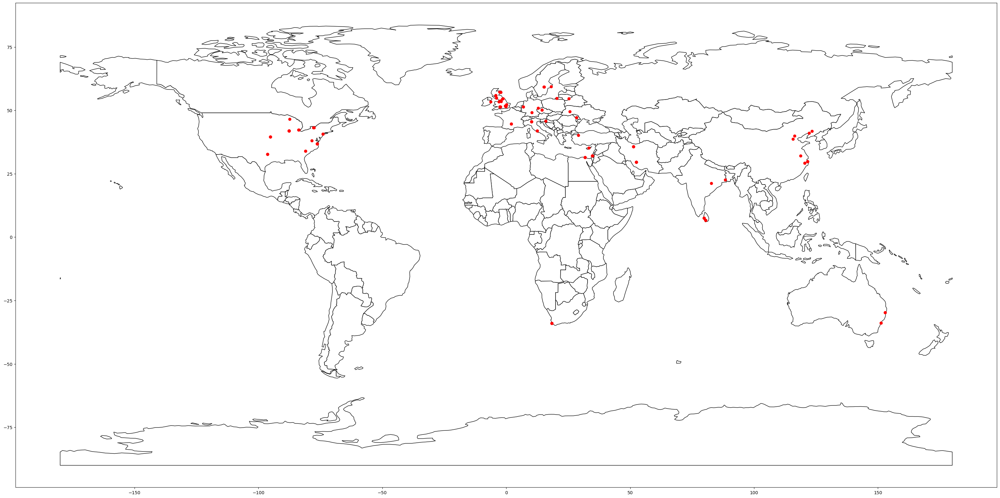

In [16]:
### Cartographier de toutes les naissances de personnes


# If we want to restrict to South America.
# world.clip([-90, -55, -25, 15])

ax = world.plot(color="white", edgecolor="black", figsize=(40,30))

# We can now plot our ``GeoDataFrame``.
birth_gdf.plot(ax=ax, color="red")

plt.show()

## Préparer et nettoyer les données


### Les lieux de naissance

In [17]:
df[['birthPlace', 'latitudeBirth', 'longitudeBirth']].head(2)

,birthPlace,latitudeBirth,longitudeBirth
0,Chemnitz,50.8333,12.9167
1,"Shadwell,_Virginia",38.0124,-78.4178


In [18]:
### Regrouper par lieu de naissance
df_lieux = pd.DataFrame(df.groupby(by=['birthPlace', 'latitudeBirth', 'longitudeBirth']).size())
df_lieux.reset_index(inplace = True)
df_lieux.columns=('birthPlace', 'latitude', 'longitude', 'effectif')
df_lieux.sort_values(by='effectif', ascending=False).head()

,birthPlace,latitude,longitude,effectif
15,Chicago,41.8819,-87.6278,12
40,"Norfolk,_Virginia",36.8469,-76.2853,6
51,Shiraz,29.6100,52.5425,5
10,Bristol,51.4500,-2.5833,5
9,Brescia,45.5417,10.2167,4


### Les géolocalisations des organisations

In [19]:
df[['organisation','latitudeOrg', 'longitudeOrg']].head(2)

,organisation,latitudeOrg,longitudeOrg
0,Leipzig_University,51.3389,12.3786
1,College_of_William_&_Mary,37.2708,-76.7083


In [20]:
### Regrouper par siège d'organisation
df_org = pd.DataFrame(df.groupby(by=['organisation','latitudeOrg', 'longitudeOrg']).size())
df_org.reset_index(inplace = True)
df_org.columns=('organisation', 'latitude', 'longitude', 'effectif')
df_org.sort_values(by='effectif', ascending=False).head()

,organisation,latitude,longitude,effectif
63,University_of_Michigan,42.2769,-83.7381,7
54,University_of_Cambridge,52.2053,0.1172,6
56,University_of_Chicago,41.7897,-87.5997,5
32,Peking_University,39.9897,116.3053,5
16,Harvard_University,42.3744,-71.1169,5


### Traiter les doublons de personnes

In [21]:
### Regrouper et compter par personne, lieu de naissance, organisation

person = pd.DataFrame(df.groupby(by=['subject_uri', 'BirthYear', 'birthPlace', 'r_property', 'organisation']).size())
person.reset_index(inplace=True)
person.columns = ("subject_uri","BirthYear","birthPlace", "r_property","organisation", "effectif")
#person.head()
show(person.sort_values(by="effectif",ascending=False))

In [22]:
person.groupby(by=["subject_uri"]).size().sort_values(ascending=False).head(8)

subject_uri
Richard_Klein_(paleoanthropologist)    6
Siran_Upendra_Deraniyagala             6
Lewis_Binford                          6
Alireza_Shapour_Shahbazi               5
Ian_Hodder                             5
Max_Mallowan                           4
Wang_Zhongshu                          4
Carmel_Schrire                         4
dtype: int64

In [23]:
df.loc[df.subject_uri=="Franklin_E._Roach"]

,subject_uri,birthPlace,r_property,organisation,BirthYear,latitudeBirth,longitudeBirth,latitudeOrg,longitudeOrg


In [24]:
pp = pd.DataFrame(df.groupby(by=['subject_uri', 'BirthYear','r_property', 'organisation']).apply(lambda x : max(x.birthPlace)))
pp.reset_index(inplace=True)
pp.columns = ("subject_uri","birthYear","r_property", "organisation","birthPlace")

pp.head()

,subject_uri,birthYear,r_property,organisation,birthPlace
0,Ahmad_Hasan_Dani,1920,almaMater,Banaras_Hindu_University,Basna
1,Alfred_V._Kidder,1885,almaMater,Harvard_University,"Marquette,_Michigan"
2,Alice_Kober,1906,almaMater,Columbia_University,New_York_City
3,Alice_Kober,1906,almaMater,Hunter_College,New_York_City
4,Alireza_Shapour_Shahbazi,1942,institution,Columbia_University,Shiraz


In [25]:
pp.groupby(by=["subject_uri","birthPlace"]).size().sort_values(ascending=False).head(8)

subject_uri                          birthPlace       
Richard_Klein_(paleoanthropologist)  Chicago              6
Lewis_Binford                        Norfolk,_Virginia    6
Alireza_Shapour_Shahbazi             Shiraz               5
Ian_Hodder                           Bristol              5
Elizabeth_Brumfiel                   Chicago              4
Carmel_Schrire                       Cape_Town            4
Paolo_Biagi                          Brescia              4
Fred_Wendorf                         Terrell,_Texas       3
dtype: int64

In [26]:
pp.loc[pp.subject_uri=="Paul_Erdős"]

,subject_uri,birthYear,r_property,organisation,birthPlace


In [27]:
### On remarque qu'il n'y a plus de doublons à cause des lieux de naissance
# que des valeur uniques pour ces trois éléments
# La table pp contient donc les données nettoyées
pp.groupby(by=["subject_uri","birthYear","r_property", "organisation"]).size().sort_values(ascending=False).head(8)

subject_uri         birthYear  r_property   organisation                
Ahmad_Hasan_Dani    1920       almaMater    Banaras_Hindu_University        1
Louise_Zarmati      1958       almaMater    University_of_Sydney            1
Paolo_Biagi         1948       almaMater    UCL_Institute_of_Archaeology    1
Muazzez_İlmiye_Çığ  1914       almaMater    Ankara_University               1
Mortimer_Wheeler    1890       almaMater    University_College_London       1
Max_Mallowan        1904       institution  All_Souls_College,_Oxford       1
                               almaMater    New_College,_Oxford             1
Martin_Rundkvist    1972       almaMater    Stockholm_University            1
dtype: int64

### Ajouter les périodes

In [28]:
min(pp.birthYear), max(pp.birthYear)

(1729, 1972)

(1729.0, 1972.0)

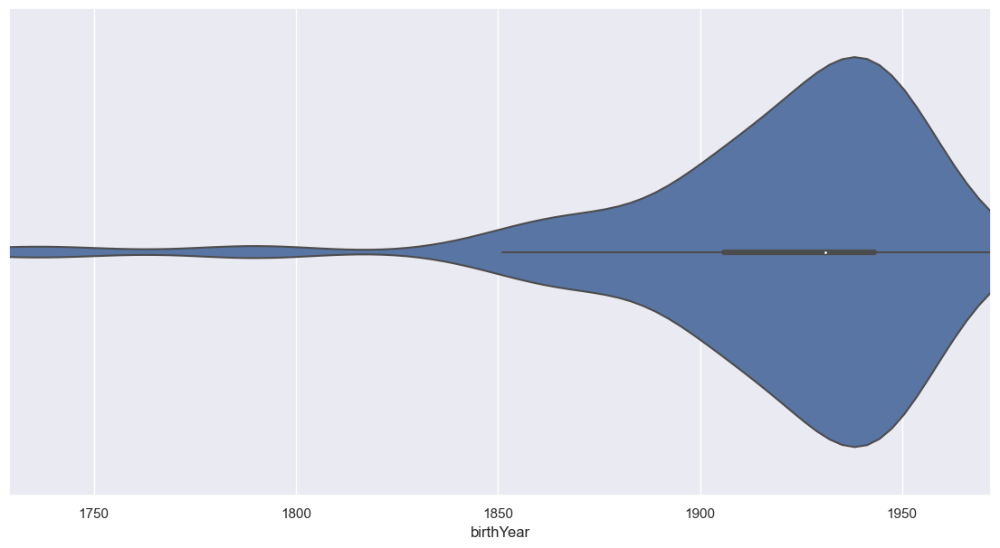

In [29]:
### Violinplot : densité des naissances dans le temps
#  https://mode.com/blog/violin-plot-examples/
#  https://seaborn.pydata.org/generated/seaborn.violinplot.html#seaborn.violinplot

sns.set_theme(style="whitegrid")

sns.set(rc={"figure.figsize":(14, 7)})

a = pp.birthYear
lim_left=min(a)
lim_right=max(a)

ax = sns.violinplot(x=a)

### Noter que au delà des limites les valeurs sont coupées car postulées
ax.set_xlim(left=lim_left, right=lim_right)

In [33]:
### Choisir des points dans le temps
# en fonction de la problématique ou heuristique
cuts = [1701, 1851, 1901, 1951, 2021]

In [34]:
pp['cut'] = pd.cut(pp['birthYear'], bins=cuts, right=False )#, labels=cuts[:-1])
pp.head(2)

,subject_uri,birthYear,r_property,organisation,birthPlace,cut
0,Ahmad_Hasan_Dani,1920,almaMater,Banaras_Hindu_University,Basna,"[1901, 1951)"
1,Alfred_V._Kidder,1885,almaMater,Harvard_University,"Marquette,_Michigan","[1851, 1901)"


In [35]:
pp['cut'] = pp['cut'].apply(lambda x : str(int(x.left))+'-'+ str(int(x.right)-1))
pp['cut'][:2]

0    1901-1950
1    1851-1900
Name: cut, dtype: category
Categories (4, object): ['1701-1850' < '1851-1900' < '1901-1950' < '1951-2020']

In [36]:
### Distribution des naissances par période
pd.DataFrame(pp.groupby(by=['cut']).size().reset_index(name='effectif'))

,cut,effectif
0,1701-1850,5
1,1851-1900,17
2,1901-1950,87
3,1951-2020,7


## Cartographier les naissances par périodes

In [37]:
birth_period = pd.DataFrame(pp.groupby(by=['birthPlace', 'cut']).size().reset_index(name='effectif'))
birth_period.columns=['birthPlace', 'year_begin', 'effectif']
birth_period.head()

,birthPlace,year_begin,effectif
0,"Ann_Arbor,_Michigan",1701-1850,0
1,"Ann_Arbor,_Michigan",1851-1900,1
2,"Ann_Arbor,_Michigan",1901-1950,0
3,"Ann_Arbor,_Michigan",1951-2020,0
4,"Atchison,_Kansas",1701-1850,0


In [38]:
### Ajouter les coordonnées des lieux de naissance 
bp_loc = pd.merge(birth_period, df_lieux, how='inner', left_on='birthPlace', 
                                     right_on='birthPlace', suffixes=('_periode', '_total')
              )
bp_loc.head()

,birthPlace,year_begin,effectif_periode,latitude,longitude,effectif_total
0,"Ann_Arbor,_Michigan",1701-1850,0,42.2714,-83.7366,1
1,"Ann_Arbor,_Michigan",1701-1850,0,42.2814,-83.7483,1
2,"Ann_Arbor,_Michigan",1851-1900,1,42.2714,-83.7366,1
3,"Ann_Arbor,_Michigan",1851-1900,1,42.2814,-83.7483,1
4,"Ann_Arbor,_Michigan",1901-1950,0,42.2714,-83.7366,1


In [39]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/
# https://plotly.com/python/scatter-plots-on-maps/

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in bp_loc.effectif_periode]

fig = px.scatter_geo(
    bp_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "birthPlace",
    animation_frame="year_begin",
    width=1400, height=600,
    color_discrete_sequence=['red'],
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox_style='stamen-watercolor',
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)

### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/birth_places.html"
fig.write_html(f_address)
fig.show()

### Grouper et compter les naissances par État contemporain

In [40]:
### Polygones des États contemporains
world.head()

,pop_est,continent,name,iso_a3,gdp_md_est,geometry
0,889953.0,Oceania,Fiji,FJI,5496,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,58005463.0,Africa,Tanzania,TZA,63177,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,603253.0,Africa,W. Sahara,ESH,907,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,37589262.0,North America,Canada,CAN,1736425,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,328239523.0,North America,United States of America,USA,21433226,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [41]:
## Projection des polygones
world.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [42]:
bp_loc.head()

,birthPlace,year_begin,effectif_periode,latitude,longitude,effectif_total
0,"Ann_Arbor,_Michigan",1701-1850,0,42.2714,-83.7366,1
1,"Ann_Arbor,_Michigan",1701-1850,0,42.2814,-83.7483,1
2,"Ann_Arbor,_Michigan",1851-1900,1,42.2714,-83.7366,1
3,"Ann_Arbor,_Michigan",1851-1900,1,42.2814,-83.7483,1
4,"Ann_Arbor,_Michigan",1901-1950,0,42.2714,-83.7366,1


In [43]:
### Transformer les coordonnées géogr. en points
bp_loc_gdf = gpd.GeoDataFrame(
    bp_loc[['birthPlace', 'effectif_periode', 'year_begin']],\
    geometry=gpd.points_from_xy(bp_loc.longitude, bp_loc.latitude), crs="EPSG:4326"
)

bp_loc_gdf.head(3)


,birthPlace,effectif_periode,year_begin,geometry
0,"Ann_Arbor,_Michigan",0,1701-1850,POINT (-83.73660 42.27140)
1,"Ann_Arbor,_Michigan",0,1701-1850,POINT (-83.74830 42.28140)
2,"Ann_Arbor,_Michigan",1,1851-1900,POINT (-83.73660 42.27140)


In [44]:
### Vérification
bp_loc_gdf.loc[bp_loc_gdf['birthPlace']=='Fresno,_California']

,birthPlace,effectif_periode,year_begin,geometry


In [45]:
### Projection des points :
# doit être la même que celle des polygones 
bp_loc_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [46]:
### Jointure spatiale, par défault inner join
# vérifie si un point se trouve dans un polygone 
# et ajoute le pays du polygone
bp_loc_join = bp_loc_gdf.sjoin(world)

In [47]:
show(bp_loc_join.sort_values(by='year_begin'), classes="display", scrollY="200px", 
     scrollCollapse=True, paging=False, column_filters="footer", dom="lrtip")

In [48]:
### Vérification
bp_loc_join.loc[bp_loc_join['birthPlace']=='Fresno,_California']

,birthPlace,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est


In [49]:
### Regrouper par pays et époque, additionner les effectifs
birth_country = pd.DataFrame(bp_loc_join[['name', 'year_begin', 'effectif_periode', 'iso_a3']].groupby(by=['name','year_begin']).sum('effectif_periode').reset_index())
birth_country.columns=['name', 'year_begin', 'somme_effectif']
birth_country.head(10)

,name,year_begin,somme_effectif
0,Australia,1701-1850,0
1,Australia,1851-1900,2
2,Australia,1901-1950,0
3,Australia,1951-2020,2
4,China,1701-1850,0
5,China,1851-1900,0
6,China,1901-1950,6
7,China,1951-2020,0
8,Croatia,1701-1850,0
9,Croatia,1851-1900,0


In [50]:
### Transformer en json
countries_polygons = world[['name', 'geometry']]
countries_polygons.index = countries_polygons['name']
countries_polygons = countries_polygons.drop(['name'], axis=1)
countries_polygons_json = json.loads(countries_polygons.to_json())
countries_polygons.head()

,geometry
name,
Fiji,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
Tanzania,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
W. Sahara,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
Canada,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
United States of America,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


In [51]:
### Le pays avec le plus de naissances par période
birth_country[birth_country.somme_effectif==max(birth_country.somme_effectif)]

,name,year_begin,somme_effectif
86,United States of America,1901-1950,29


In [52]:
### Distribution des effectifs des naissances
birth_country.somme_effectif.describe()

count    88.000000
mean      1.295455
std       3.623547
min       0.000000
25%       0.000000
50%       0.000000
75%       1.000000
max      29.000000
Name: somme_effectif, dtype: float64

In [53]:
### Distribution dans le dernier quartile
birth_country[birth_country.somme_effectif>6].somme_effectif.describe()

count     3.000000
mean     17.000000
std      10.583005
min       9.000000
25%      11.000000
50%      13.000000
75%      21.000000
max      29.000000
Name: somme_effectif, dtype: float64

In [54]:
# Représenter la densité de naissances de mathématiciens par pays
# https://plotly.com/python/animations/
# https://plotly.com/python-api-reference/generated/plotly.express.choropleth_mapbox.html
# https://medium.com/@lucas_bromerchenkel/choropleth-maps-with-time-sliders-using-plotly-df6e19e5f90c

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in bp_loc.effectif_periode]

fig = px.choropleth_mapbox(
    birth_country,
    geojson=countries_polygons_json,
    locations="name",
    color="somme_effectif",
    mapbox_style='white-bg',
    zoom=1,
    color_continuous_scale='blues',
    ### valeur 20 définie en fonction de la distribution par pays
    # expérimenter en changeant la valeur
    range_color=(1, 20),
    animation_frame="year_begin",
    width=1000, height=600,
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 0, "t": 30, "b": 0}

)
### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/birth_places_choropleth.html"
fig.write_html(f_address)

fig.show()

## Cartographier les organisations par périodes

In [55]:
org_period = pd.DataFrame(pp.groupby(by=['organisation', 'cut']).size().reset_index(name='effectif'))
org_period.columns=['organisation', 'year_begin', 'effectif']
org_period.head()

,organisation,year_begin,effectif
0,Albion_College,1701-1850,0
1,Albion_College,1851-1900,0
2,Albion_College,1901-1950,1
3,Albion_College,1951-2020,0
4,Alexandria_University,1701-1850,0


In [56]:
### Ajouter les coordonnées des lieux de naissance 
org_loc = pd.merge(org_period, df_org, how='inner', left_on='organisation', 
                                     right_on='organisation', suffixes=('_periode', '_total')
              )
org_loc.head()

,organisation,year_begin,effectif_periode,latitude,longitude,effectif_total
0,Albion_College,1701-1850,0,42.2445,-84.7434,1
1,Albion_College,1851-1900,0,42.2445,-84.7434,1
2,Albion_College,1901-1950,1,42.2445,-84.7434,1
3,Albion_College,1951-2020,0,42.2445,-84.7434,1
4,Alexandria_University,1701-1850,0,31.2019,29.9053,1


In [57]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/


size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

px.scatter_geo(
    org_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "organisation",
    animation_frame="year_begin",
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
).update_layout(
     mapbox={"style": "carto-positron", "zoom":11},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)


### Grouper et compter les appartenance aux organisations par État contemporain

In [58]:
org_loc.head()

,organisation,year_begin,effectif_periode,latitude,longitude,effectif_total
0,Albion_College,1701-1850,0,42.2445,-84.7434,1
1,Albion_College,1851-1900,0,42.2445,-84.7434,1
2,Albion_College,1901-1950,1,42.2445,-84.7434,1
3,Albion_College,1951-2020,0,42.2445,-84.7434,1
4,Alexandria_University,1701-1850,0,31.2019,29.9053,1


In [59]:
### Transformer les coordonnées géogr. en points
org_loc_gdf = gpd.GeoDataFrame(
    org_loc[['organisation', 'effectif_periode', 'year_begin']],\
    geometry=gpd.points_from_xy(org_loc.longitude, org_loc.latitude), crs="EPSG:4326"
)

org_loc_gdf.head(5)


,organisation,effectif_periode,year_begin,geometry
0,Albion_College,0,1701-1850,POINT (-84.74340 42.24450)
1,Albion_College,0,1851-1900,POINT (-84.74340 42.24450)
2,Albion_College,1,1901-1950,POINT (-84.74340 42.24450)
3,Albion_College,0,1951-2020,POINT (-84.74340 42.24450)
4,Alexandria_University,0,1701-1850,POINT (29.90530 31.20190)


In [60]:
### Projection des points :
# doit être la même que celle des polygones 
org_loc_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [61]:
### Jointure spatiale, par défault inner join
# vérifie si un point se trouve dans un polygone 
# et ajoute le pays du polygone
org_loc_join = org_loc_gdf.sjoin(world)

In [62]:
show(org_loc_join.sort_values(by='year_begin'), classes="display", scrollY="200px", 
     scrollCollapse=True, paging=False, column_filters="footer", dom="lrtip")

In [63]:
### Vérification
org_loc_join.loc[org_loc_join['organisation']=='Indiana_University']

,organisation,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est


In [64]:
### Regrouper par pays et époque, additionner les effectifs
org_country = pd.DataFrame(org_loc_join[['name', 'year_begin', 'effectif_periode', 'iso_a3']].groupby(by=['name', 'year_begin']).sum('effectif_periode').reset_index())
org_country.columns=['name', 'year_begin', 'somme_effectif']
org_country.head(10)

,name,year_begin,somme_effectif
0,Australia,1701-1850,0
1,Australia,1851-1900,1
2,Australia,1901-1950,1
3,Australia,1951-2020,2
4,Austria,1701-1850,0
5,Austria,1851-1900,0
6,Austria,1901-1950,1
7,Austria,1951-2020,0
8,Canada,1701-1850,0
9,Canada,1851-1900,0


In [65]:
### Transformer en json

# countries_polygons_json créé ci-dessus

In [66]:
### Le pays avec le plus d'organisations par période
org_country[org_country.somme_effectif==max(org_country.somme_effectif)]

,name,year_begin,somme_effectif
82,United States of America,1901-1950,36


In [67]:
### Distribution des effectifs des appartenances aux organisations
org_country.somme_effectif.describe()

count    84.000000
mean      1.369048
std       4.387221
min       0.000000
25%       0.000000
50%       0.000000
75%       1.000000
max      36.000000
Name: somme_effectif, dtype: float64

In [68]:
### Distribution dans le dernier quartile
org_country[org_country.somme_effectif>6].somme_effectif.describe()

count     3.000000
mean     19.666667
std      14.843629
min       7.000000
25%      11.500000
50%      16.000000
75%      26.000000
max      36.000000
Name: somme_effectif, dtype: float64

In [69]:
# Représenter la densité de naissances de mathématiciens par pays
# https://plotly.com/python/animations/
# https://plotly.com/python-api-reference/generated/plotly.express.choropleth_mapbox.html
# https://medium.com/@lucas_bromerchenkel/choropleth-maps-with-time-sliders-using-plotly-df6e19e5f90c

# np.log(s) * 1000
size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

px.choropleth_mapbox(
    org_country,
    geojson=countries_polygons_json,
    locations="name",
    color="somme_effectif",

    mapbox_style='white-bg',
    zoom=1,
    color_continuous_scale='reds',
    ### valeur 20 définie en fonction de la distribution par pays
    # expérimenter en changeant la valeur
    range_color=(1, 35),
    animation_frame="year_begin",
    width=1000, height=600,
    title="Evolution des lieux de naissance"
).update_layout(
    #mapbox={"style": "carto-positron", "zoom":10},
    margin={"l": 0, "r": 0, "t": 30, "b": 0}

)


## Créer les pairs d'organisations

In [70]:
### Reprendre la liste nettoyée des personnes
pp.head()

,subject_uri,birthYear,r_property,organisation,birthPlace,cut
0,Ahmad_Hasan_Dani,1920,almaMater,Banaras_Hindu_University,Basna,1901-1950
1,Alfred_V._Kidder,1885,almaMater,Harvard_University,"Marquette,_Michigan",1851-1900
2,Alice_Kober,1906,almaMater,Columbia_University,New_York_City,1901-1950
3,Alice_Kober,1906,almaMater,Hunter_College,New_York_City,1901-1950
4,Alireza_Shapour_Shahbazi,1942,institution,Columbia_University,Shiraz,1901-1950


In [71]:
### Reprendre la liste des organisations spatialisées
org_loc_join.head()

,organisation,effectif_periode,year_begin,geometry,index_right,pop_est,continent,name,iso_a3,gdp_md_est
0,Albion_College,0,1701-1850,POINT (-84.74340 42.24450),4,328239523.0,North America,United States of America,USA,21433226
1,Albion_College,0,1851-1900,POINT (-84.74340 42.24450),4,328239523.0,North America,United States of America,USA,21433226
2,Albion_College,1,1901-1950,POINT (-84.74340 42.24450),4,328239523.0,North America,United States of America,USA,21433226
3,Albion_College,0,1951-2020,POINT (-84.74340 42.24450),4,328239523.0,North America,United States of America,USA,21433226
20,Arizona_State_University,0,1701-1850,POINT (-111.93300 33.42100),4,328239523.0,North America,United States of America,USA,21433226


In [72]:
org_country = pd.DataFrame(org_loc_join.groupby(by=["organisation", "name"]).sum("effectif_periode"))
org_country = org_country.reset_index()
org_country = org_country.drop(columns=["index_right", "pop_est", "gdp_md_est"])
org_country.columns=["organisation", "name", "effectif_total"]
org_country.sort_values(by="effectif_total", ascending=False ).head()

,organisation,name,effectif_total
63,University_of_Michigan,United States of America,6
54,University_of_Cambridge,United Kingdom,6
56,University_of_Chicago,United States of America,5
74,University_of_Tehran,Iran,4
16,Harvard_University,United States of America,4


In [73]:
ppm = pd.merge(pp, org_country, left_on="organisation", right_on="organisation", suffixes=('_p', '_y'))
ppm.head()

,subject_uri,birthYear,r_property,organisation,birthPlace,cut,name,effectif_total
0,Ahmad_Hasan_Dani,1920,almaMater,Banaras_Hindu_University,Basna,1901-1950,India,1
1,Alfred_V._Kidder,1885,almaMater,Harvard_University,"Marquette,_Michigan",1851-1900,United States of America,4
2,Alireza_Shapour_Shahbazi,1942,institution,Harvard_University,Shiraz,1901-1950,United States of America,4
3,Fred_Wendorf,1924,almaMater,Harvard_University,"Terrell,_Texas",1901-1950,United States of America,4
4,Siran_Upendra_Deraniyagala,1942,almaMater,Harvard_University,Ratnapura,1901-1950,United States of America,4


In [74]:
[p for p in ppm.values][:2]

[array(['Ahmad_Hasan_Dani', 1920, 'almaMater', 'Banaras_Hindu_University',
        'Basna', '1901-1950', 'India', 1], dtype=object),
 array(['Alfred_V._Kidder', 1885, 'almaMater', 'Harvard_University',
        'Marquette,_Michigan', '1851-1900', 'United States of America', 4],
       dtype=object)]

In [75]:
## Pairs d'organisations
pairs_o = []

for s1 in ppm.sort_values(by='organisation').values:
    for s2 in ppm.sort_values(by='organisation').values:
        if s1[3] < s2[3] \
            and s1[0] == s2[0]:
                pairs_o.append([s1[3],s2[3], s1[5], s1[6], s2[6]])
        else:
            pass

In [76]:
len(pairs_o), pairs_o[:2]

(94,
 [['Albion_College',
   'Northwestern_University',
   '1901-1950',
   'United States of America',
   'United States of America'],
  ['Albion_College',
   'University_of_California,_Los_Angeles',
   '1901-1950',
   'United States of America',
   'United States of America']])

In [77]:
### Créér dataframe et compter
liens_org = pd.DataFrame(pairs_o)
liens_org.columns=('org_1', 'org_2', 'periode', 'etat_1', 'etat_2')
liens_org.head()

,org_1,org_2,periode,etat_1,etat_2
0,Albion_College,Northwestern_University,1901-1950,United States of America,United States of America
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,United States of America,United States of America
2,Albion_College,University_of_Michigan,1901-1950,United States of America,United States of America
3,Alexandria_University,Cairo_University,1901-1950,Egypt,Egypt
4,Alexandria_University,University_of_Pennsylvania,1901-1950,Egypt,United States of America


In [78]:
liens_org_grp = pd.DataFrame(liens_org.groupby(by=['org_1', 'org_2', 'periode']).size())
liens_org_grp=liens_org_grp.reset_index()
liens_org_grp.columns=['org_1', 'org_2', 'periode', 'effectif']
liens_org_grp.sort_values(by='effectif', ascending=False).head()

,org_1,org_2,periode,effectif
69,University_of_Chicago,University_of_Michigan,1901-1950,5
60,Tel_Aviv_University,University_of_Haifa,1901-1950,2
38,Northwestern_University,University_of_Michigan,1901-1950,2
37,Northwestern_University,University_of_Chicago,1901-1950,2
56,Stanford_University,University_of_Chicago,1901-1950,2


In [79]:
### Ajouter les coordonnées des lieux de naissance 
org_1_loc = pd.merge(liens_org_grp, df_org, how='inner', left_on='org_1', 
                                     right_on='organisation', suffixes=('_p', '_y')
              )
org_1_loc=org_1_loc.drop(columns=['organisation','effectif_y'])
org_1_loc.head()

,org_1,org_2,periode,effectif_p,latitude,longitude
0,Albion_College,Northwestern_University,1901-1950,1,42.2445,-84.7434
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,1,42.2445,-84.7434
2,Albion_College,University_of_Michigan,1901-1950,1,42.2445,-84.7434
3,Alexandria_University,Cairo_University,1901-1950,1,31.2019,29.9053
4,Alexandria_University,University_of_Pennsylvania,1901-1950,1,31.2019,29.9053


In [80]:
### Ajouter les coordonnées des lieux de naissance 
orgs_loc = pd.merge(org_1_loc, df_org, how='inner', left_on='org_2', 
                                     right_on='organisation', suffixes=('_1', '_2')
              )
orgs_loc=orgs_loc.drop(columns=['organisation','effectif'])
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2
0,Albion_College,Northwestern_University,1901-1950,1,42.2445,-84.7434,42.0548,-87.6739
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,1,42.2445,-84.7434,34.0694,-118.4453
2,Northwestern_University,"University_of_California,_Los_Angeles",1901-1950,1,42.0548,-87.6739,34.0694,-118.4453
3,Albion_College,University_of_Michigan,1901-1950,1,42.2445,-84.7434,42.2769,-83.7381
4,Northwestern_University,University_of_Michigan,1901-1950,2,42.0548,-87.6739,42.2769,-83.7381


In [81]:
orgs_loc['geometry'] = orgs_loc.apply(lambda x: LineString([(x['longitude_1'], x['latitude_1']) , (x['longitude_2'], x['latitude_2'])]), axis = 1)
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2,geometry
0,Albion_College,Northwestern_University,1901-1950,1,42.2445,-84.7434,42.0548,-87.6739,"LINESTRING (-84.7434 42.2445, -87.6739 42.0548)"
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,1,42.2445,-84.7434,34.0694,-118.4453,"LINESTRING (-84.7434 42.2445, -118.4453 34.0694)"
2,Northwestern_University,"University_of_California,_Los_Angeles",1901-1950,1,42.0548,-87.6739,34.0694,-118.4453,"LINESTRING (-87.6739 42.0548, -118.4453 34.0694)"
3,Albion_College,University_of_Michigan,1901-1950,1,42.2445,-84.7434,42.2769,-83.7381,"LINESTRING (-84.7434 42.2445, -83.7381 42.2769)"
4,Northwestern_University,University_of_Michigan,1901-1950,2,42.0548,-87.6739,42.2769,-83.7381,"LINESTRING (-87.6739 42.0548, -83.7381 42.2769)"


In [82]:
orgs_loc.columns

Index(['org_1', 'org_2', 'periode', 'effectif_p', 'latitude_1', 'longitude_1',
       'latitude_2', 'longitude_2', 'geometry'],
      dtype='object')

In [83]:
orgs_gdf = gpd.GeoDataFrame(
    orgs_loc[['org_1', 'org_2','periode','effectif_p', 'geometry']]
)

orgs_gdf.head(3)

,org_1,org_2,periode,effectif_p,geometry
0,Albion_College,Northwestern_University,1901-1950,1,"LINESTRING (-84.74340 42.24450, -87.67390 42.0..."
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,1,"LINESTRING (-84.74340 42.24450, -118.44530 34...."
2,Northwestern_University,"University_of_California,_Los_Angeles",1901-1950,1,"LINESTRING (-87.67390 42.05480, -118.44530 34...."


In [84]:
orgs_gdf = orgs_gdf.set_geometry('geometry')
orgs_gdf = orgs_gdf.set_crs('EPSG:4326')
orgs_gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

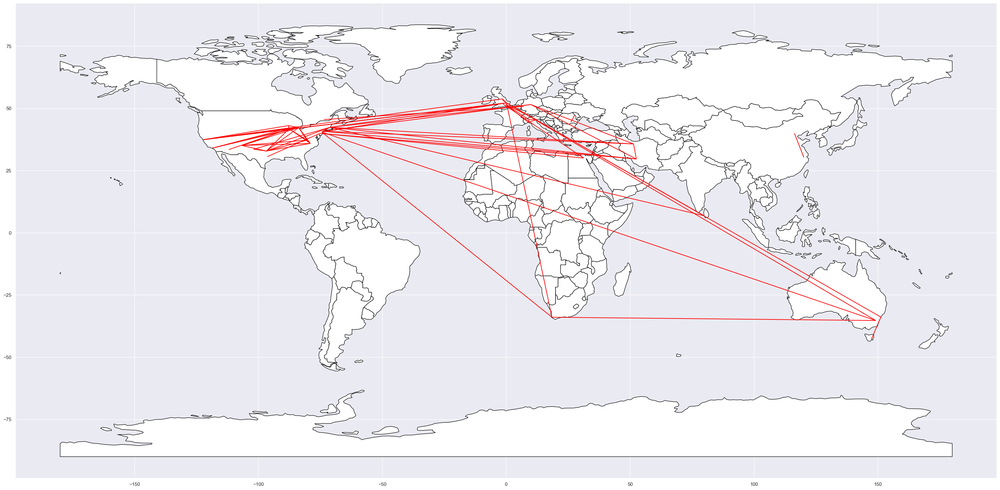

In [85]:
### Cartographier


# If we want to restrict to South America.
# world.clip([-90, -55, -25, 15])

ax = world.plot(color="white", edgecolor="black", figsize=(40,30))

# We can now plot our ``GeoDataFrame``.
orgs_gdf.plot(ax=ax, color="red")

plt.show()

In [86]:
orgs_loc.head()

,org_1,org_2,periode,effectif_p,latitude_1,longitude_1,latitude_2,longitude_2,geometry
0,Albion_College,Northwestern_University,1901-1950,1,42.2445,-84.7434,42.0548,-87.6739,"LINESTRING (-84.7434 42.2445, -87.6739 42.0548)"
1,Albion_College,"University_of_California,_Los_Angeles",1901-1950,1,42.2445,-84.7434,34.0694,-118.4453,"LINESTRING (-84.7434 42.2445, -118.4453 34.0694)"
2,Northwestern_University,"University_of_California,_Los_Angeles",1901-1950,1,42.0548,-87.6739,34.0694,-118.4453,"LINESTRING (-87.6739 42.0548, -118.4453 34.0694)"
3,Albion_College,University_of_Michigan,1901-1950,1,42.2445,-84.7434,42.2769,-83.7381,"LINESTRING (-84.7434 42.2445, -83.7381 42.2769)"
4,Northwestern_University,University_of_Michigan,1901-1950,2,42.0548,-87.6739,42.2769,-83.7381,"LINESTRING (-87.6739 42.0548, -83.7381 42.2769)"


In [87]:
orgs_loc.columns

Index(['org_1', 'org_2', 'periode', 'effectif_p', 'latitude_1', 'longitude_1',
       'latitude_2', 'longitude_2', 'geometry'],
      dtype='object')

In [88]:
orgs_loc = orgs_loc.sort_values(by='periode')

In [89]:
#
lats = []
for s in orgs_loc.values:
    lats.append(np.array(np.float64(s[4]), np.float64(s[6])))
lats[:3]

[array(48.8492), array(52.2053), array(30.0478)]

In [90]:
#
longs = []
for s in orgs_loc.values:
    longs.append(np.array(np.float64(s[5]), np.float64(s[7])))
longs[:3]

[array(2.3456), array(0.1172), array(31.2333)]

In [91]:
#
names = []
for s in orgs_loc.values:
    names.append(s[0]+ '_' + s[1])
names[:3]

['Collège_de_France_Institut_national_des_langues_et_civilisations_orientales',
 'University_of_Cambridge_University_of_Sydney',
 'Egyptian_Museum_Oriel_College,_Oxford']

In [92]:
#
size = []
for s in orgs_loc.values:
    size.append(s[3])
size[:3]

[1, 1, 1]

In [93]:
#
periodes = []
for s in orgs_loc.values:
    periodes.append(s[2])
periodes[:3]

['1701-1850', '1851-1900', '1851-1900']

In [94]:
# now just plot it on a map with evolution by time
# https://plotly.com/python/animations/


size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

size = [s if s != 0 else 0 for s in org_loc.effectif_periode]

"""px.scatter_geo(
    org_loc,
    lat="latitude",
    lon="longitude",
    size=size,
    hover_name = "organisation",
    animation_frame="year_begin",
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
)"""

fig = px.line_geo(#data_frame=orgs_loc,
            lat=lats, lon=longs, 
       # hover_name=names,
    #size=size,
    animation_frame=periodes,
    width=1200, height=600,
    color_discrete_sequence=['red'], 
    title="Evolution des emplacements des organisations" 
).update_layout(
     mapbox={"style": "carto-positron", "zoom":11},
    margin={"l": 0, "r": 20, "t": 30, "b": 0}

)

### Enregistrer l'image, puis l'ouvrir dans un autre onglet du navigateur
f_address = "pictures/org_relationships.html"
fig.write_html(f_address)

fig.show()

### Observer plus finemenent

In [95]:
liens_etat_grp = pd.DataFrame(liens_org.groupby(by=['etat_1', 'etat_2', 'periode']).size())
liens_etat_grp=liens_etat_grp.reset_index()
liens_etat_grp.columns=['etat_1', 'etat_2', 'periode', 'effectif']
liens_etat_grp.sort_values(by='effectif', ascending=False).head()

,etat_1,etat_2,periode,effectif
29,United States of America,United States of America,1901-1950,44
21,United Kingdom,United Kingdom,1901-1950,7
28,United States of America,United Kingdom,1901-1950,4
25,United States of America,Iran,1901-1950,4
14,Italy,Italy,1901-1950,3


In [96]:
liens_etat_grp['relation'] = liens_etat_grp.apply(lambda x : x.etat_1 + "-" + x.etat_2, axis=1)
liens_etat_grp.head()

,etat_1,etat_2,periode,effectif,relation
0,Australia,Australia,1951-2020,1,Australia-Australia
1,Australia,South Africa,1901-1950,1,Australia-South Africa
2,Australia,United Kingdom,1901-1950,1,Australia-United Kingdom
3,Australia,United States of America,1901-1950,1,Australia-United States of America
4,Canada,Germany,1901-1950,1,Canada-Germany


In [97]:
liste_relations = pd.DataFrame(liens_etat_grp.groupby(by='relation').sum('effectif'))
liste_relations = liste_relations.reset_index()
liste_relations.sort_values(by='effectif',ascending=False).head(10)

,relation,effectif
28,United States of America-United States of America,44
21,United Kingdom-United Kingdom,8
27,United States of America-United Kingdom,4
24,United States of America-Iran,4
12,Iran-Iran,3
14,Italy-Italy,3
19,United Kingdom-Italy,2
8,Egypt-United States of America,2
13,Israel-Israel,2
23,United States of America-Germany,2


In [98]:
l_rel = list(liste_relations.relation)
l_rel[:3]

['Australia-Australia', 'Australia-South Africa', 'Australia-United Kingdom']

In [99]:
### Distribution des naissances par période
df_cut = pd.DataFrame(pp.groupby(by=['cut']).size().reset_index(name='effectif'))
df_cut

,cut,effectif
0,1701-1850,5
1,1851-1900,17
2,1901-1950,87
3,1951-2020,7


In [100]:
v_cut = list(df_cut.cut)
v_cut

['1701-1850', '1851-1900', '1901-1950', '1951-2020']

In [101]:
toute_relation = []
for r in l_rel:
    for c in v_cut:
        toute_relation.append([r,c])
df_toute_rel = pd.DataFrame(toute_relation)
df_toute_rel.columns = ('relation', 'periode')
df_toute_rel.head(10)

,relation,periode
0,Australia-Australia,1701-1850
1,Australia-Australia,1851-1900
2,Australia-Australia,1901-1950
3,Australia-Australia,1951-2020
4,Australia-South Africa,1701-1850
5,Australia-South Africa,1851-1900
6,Australia-South Africa,1901-1950
7,Australia-South Africa,1951-2020
8,Australia-United Kingdom,1701-1850
9,Australia-United Kingdom,1851-1900


In [102]:
merge_relations = pd.merge(df_toute_rel, liens_etat_grp[['periode', 'effectif', 'relation']], how='left',  left_on=['relation', 'periode'], right_on=['relation', 'periode'])
merge_relations.head(10)

,relation,periode,effectif
0,Australia-Australia,1701-1850,NaN
1,Australia-Australia,1851-1900,NaN
2,Australia-Australia,1901-1950,NaN
3,Australia-Australia,1951-2020,1.0
4,Australia-South Africa,1701-1850,NaN
5,Australia-South Africa,1851-1900,NaN
6,Australia-South Africa,1901-1950,1.0
7,Australia-South Africa,1951-2020,NaN
8,Australia-United Kingdom,1701-1850,NaN
9,Australia-United Kingdom,1851-1900,NaN


In [103]:
merge_relations.effectif = merge_relations.effectif.fillna(0)
merge_relations.effectif= merge_relations.effectif.apply(lambda x : int(x))
merge_relations.head(10)

,relation,periode,effectif
0,Australia-Australia,1701-1850,0
1,Australia-Australia,1851-1900,0
2,Australia-Australia,1901-1950,0
3,Australia-Australia,1951-2020,1
4,Australia-South Africa,1701-1850,0
5,Australia-South Africa,1851-1900,0
6,Australia-South Africa,1901-1950,1
7,Australia-South Africa,1951-2020,0
8,Australia-United Kingdom,1701-1850,0
9,Australia-United Kingdom,1851-1900,0


In [104]:
file_addr = 'data/merge_relations.csv'
merge_relations.to_csv(file_addr)

In [105]:
show(merge_relations)

In [106]:
list(merge_relations.sort_values(by='periode').periode.unique())

['1701-1850', '1851-1900', '1901-1950', '1951-2020']

In [107]:
### Explorer par des filtres Pandas
liens_etat_grp[liens_etat_grp.periode=="1451-1800"].sort_values(by=["effectif"],ascending=False).head(10)

,etat_1,etat_2,periode,effectif,relation


### Création et utilisation d'une fonction d'affichage

In [108]:
# generate the plot

def generate_fig(df, country=None, load_image = False):
    
    if country:
        dataframe = df[df.relation.str.contains(country)]
    else:
        dataframe = df
    
    fig = px.bar(
        dataframe,
        x="effectif",
        y="relation",
        base="relation",
        #color="effectif",
        #orientation="h",
        height= len(dataframe)*5,
        width=1000,
        animation_frame="periode"

    )

    fig.update_layout(
        margin=dict(l=2, r=100, t=0, b=5),
        paper_bgcolor="LightSteelBlue",
        xaxis={"range":[0,list(merge_relations.effectif.quantile([0.99]))[0]]}
#                        dataframe.effectif.max()]}
    )
    
    ### enregistrer au format HTML et ouvrir comme page web
    if country:
        f_address = "pictures/countries_relations_" + country + ".html"
    else:
        f_address = "pictures/countries_relations.html"
    fig.write_html(f_address)

    ### On n'affiche pas l'image directement mais on la sauvegarde dans un fichier,
    # puis on affiche le fichier dans le carnet Jupyter avec l'instruction display.HMTL,
    # cf. ci-dessous. On peut aussi ouvrir le fichier dans une autre fenêtre
    
    if load_image == False:
        fig.show()
    else:
        i = IPython.display.HTML(filename=f_address)
        return i



In [109]:
### inspecter le dataframe complet
df = merge_relations
generate_fig(df)

In [110]:
### Filtrer sur le nom d'un pays
generate_fig(df, 'Italy', load_image=True)